## eSTAT_clus4を大阪府の地図にマッピング
下記のサンプルコードが動くことが確認できたので、Societyで以前マッピングに利用したデータを使って、大阪府の地図にマッピングするように書き換える実験を行った。</br>
https://soan.jp/plotly

In [2]:
!pip install geocoder

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 98.6/98.6 kB 4.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 840.9/840.9 kB 17.2 MB/s eta 0:00:00a 0:00:01
  Preparing metadata (setup.py) ... done
  Created wheel for future: filename=future-0.18.3-py3-none-any.whl size=492025 sha256=88fd4e8a9b9b75a3e346c9d933ab860b8a09cc6801065201e8d0fedac8f751c8
  Stored in directory: /home/jovyan/.cache/pip/wheels/5e/a9/47/f118e66afd12240e4662752cc22cefae5d97275623aa8ef57d
Successfully built future

[notice] A new release of pip is available: 23.1.2 -> 23.2.1
[notice] To update, run: pip install --upgrade pip


In [9]:
import json
import re
import pandas as pd
import plotly.express as px
import geocoder as geocoder

# 定数
PREFECTURE = "大阪府"
CSV_FILE = "./data/estat_clus4.csv"
GEOJSON_FILE = "./data/N03-20_27_200101.geojson"
MAPBOX_STYLE = "carto-positron"
#COLOR_RANGE = (1, 4)
ZOOM_LEVEL = 8
OPACITY = 0.5
FIG_SIZE = 800

color_mapping = {
    "1": "red",    
    "2": "green",  
    "3": "blue",
    "4": "yellow"
}

In [10]:
def load_data(CSV_FILE, geojson_file):
    """CSVファイルとGeoJSONファイルからデータフレームとGeoJSONを作成する"""
    # XLSファイルから人口データフレーム作成
    df = pd.read_csv('./data/estat_clus4.csv', header=0,dtype= str)
    #大阪府のみ抽出
    #df = df[df['area'].str.startswith('27')]
    # クラスを数値型に変換する
    #df[['clus']] = df[['clus']].replace(',', '', regex=True).astype('float')

    # GeoJSONファイルから地図データ読み込み
    with open(geojson_file) as f:
        geojson = json.load(f)
        # GeoJSONデータから不要な列を削除する
        for feature in geojson['features']:
            feature['properties'].pop('N03_001')
            feature['properties'].pop('N03_002')
            feature['properties'].pop('N03_003')
            feature['properties'].pop('N03_004')

    return df, geojson

def plot_map(df, geojson, prefecture):
    """データフレームとGeoJSONから地図をプロットする"""
    # 都道府県の中心座標を取得
    center_latlng = geocoder.arcgis(prefecture).latlng

    # コロプレスマップを描画
    fig = px.choropleth_mapbox(
        df,
        geojson=geojson,
        locations="area",
        color="clus",
        color_discrete_map=color_mapping,  # 色を固定値で指定
     #   hover_name="clus",
     #   hover_data=["clus", "area"],
        featureidkey="properties.N03_007",
        mapbox_style=MAPBOX_STYLE,
     #   range_color=COLOR_RANGE,
        zoom=ZOOM_LEVEL,
        center={"lat": center_latlng[0]-0.5, "lon": center_latlng[1]},
        opacity=OPACITY,
        width=FIG_SIZE,
        height=FIG_SIZE,
    )
    fig.update_layout(margin=dict(b=0, t=0, l=0, r=0))
    fig.show()

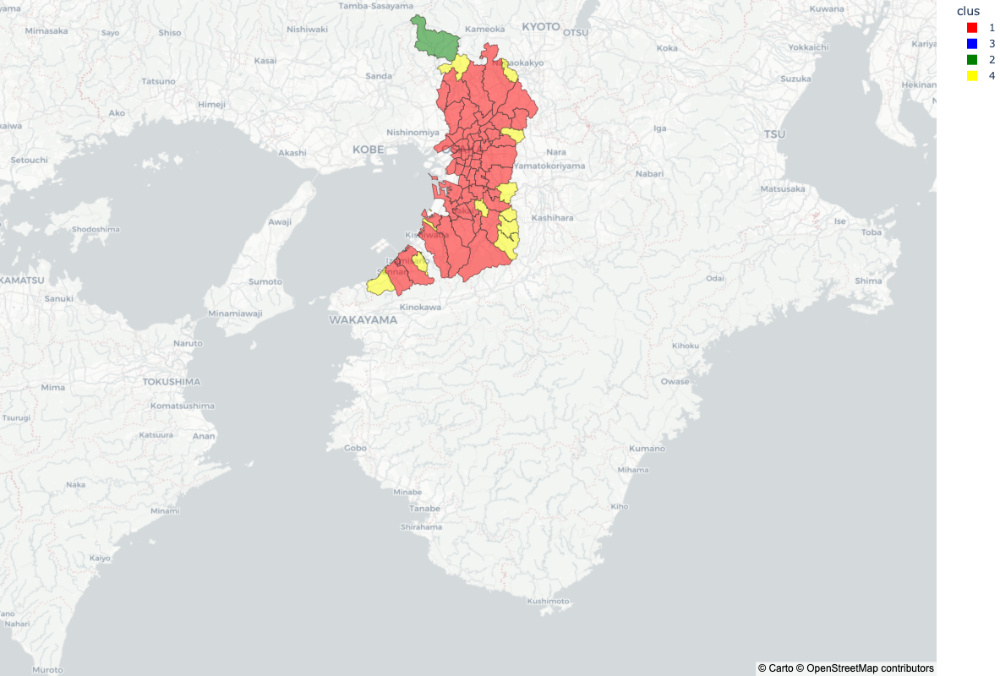

In [11]:
# メイン処理
if __name__ == "__main__":
    df_osaka, geojson_osaka = load_data(CSV_FILE, GEOJSON_FILE)
    plot_map(df_osaka, geojson_osaka, PREFECTURE)

In [45]:
df_osaka.dtypes

area    object
clus    object
dtype: object

In [49]:
df_osaka

,area,clus
1190,27102,1
1191,27103,1
1192,27104,1
1193,27106,1
1194,27107,1
...,...,...
1257,27362,1
1258,27366,4
1259,27381,4
1260,27382,4


In [54]:
# Geojsonのファイルのエリアコードを確認する
for i in range(len(geojson_osaka["features"])):
  print(geojson_osaka["features"][i]["properties"])

{'N03_007': None}
{'N03_007': '27102'}
{'N03_007': '27103'}
{'N03_007': '27104'}
{'N03_007': '27104'}
{'N03_007': '27104'}
{'N03_007': '27104'}
{'N03_007': '27104'}
{'N03_007': '27104'}
{'N03_007': '27104'}
{'N03_007': '27104'}
{'N03_007': '27104'}
{'N03_007': '27106'}
{'N03_007': '27107'}
{'N03_007': '27107'}
{'N03_007': '27107'}
{'N03_007': '27108'}
{'N03_007': '27108'}
{'N03_007': '27109'}
{'N03_007': '27111'}
{'N03_007': '27113'}
{'N03_007': '27114'}
{'N03_007': '27115'}
{'N03_007': '27116'}
{'N03_007': '27117'}
{'N03_007': '27118'}
{'N03_007': '27119'}
{'N03_007': '27120'}
{'N03_007': '27121'}
{'N03_007': '27122'}
{'N03_007': '27123'}
{'N03_007': '27124'}
{'N03_007': '27125'}
{'N03_007': '27125'}
{'N03_007': '27125'}
{'N03_007': '27125'}
{'N03_007': '27125'}
{'N03_007': '27126'}
{'N03_007': '27127'}
{'N03_007': '27128'}
{'N03_007': '27141'}
{'N03_007': '27141'}
{'N03_007': '27141'}
{'N03_007': '27141'}
{'N03_007': '27142'}
{'N03_007': '27143'}
{'N03_007': '27144'}
{'N03_007': '271

In [58]:
len(geojson_osaka["features"])

144